In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from scipy.spatial.distance import pdist, squareform
import community as community_louvain
from networkx.algorithms import community
import igraph as ig
from igraph import Graph, plot
import networkx as nx
import cairocffi
import igraph
#from igraph import *
import random
from scipy import stats
from scipy.stats import pearsonr, spearmanr
from scipy.cluster.hierarchy import linkage, dendrogram
from matplotlib.lines import Line2D
from PIL import Image

Load data

In [2]:
# otu table
ecdata = pd.read_csv("otu.csv", index_col="EC")
ecdata = ecdata.drop(columns=["prt_read_lenght_av"])

# pathways table
pathways_df = pd.read_csv('Carbon_EC_numbers - Pathways_overlap.csv')
ec_c_fixation_df = pathways_df[pathways_df['pathway'].isin(['3HBC', 'CBB', 'DCHB', 'HPHB', 'rTCA', 'WL'])]
ec_list = pathways_df.EC.values.flatten() #List of all C related ECs
ec_c_fixation_list = ec_c_fixation_df.EC.values.flatten() #List of C-fixation related ECs



#ADDED on 20241010: i joint the otu from Fullerton
ecdata_fullerton = pd.read_csv("mifaser_dataset_from_Fullerton.csv", index_col="EC").drop(ecdata_fullerton.columns[0], axis=1)
merged_df = pd.concat([ecdata, ecdata_fullerton], axis=1, join='outer')
ecdata = merged_df

Prevalence analysis (first with sum of abundance / second with mean abundance)

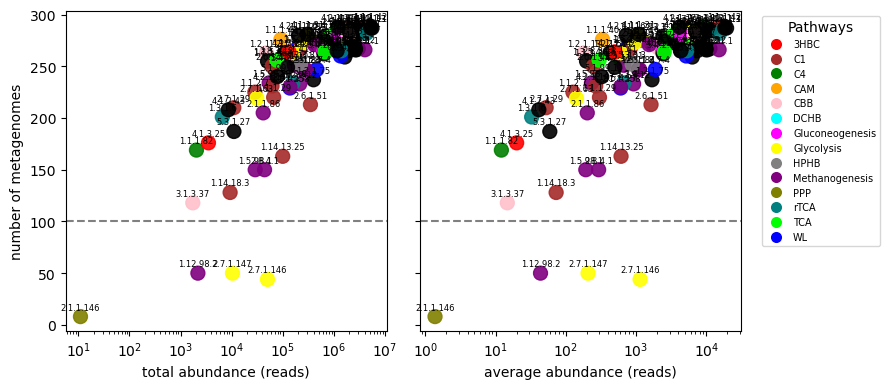

In [3]:
tested_df = ecdata.loc[ecdata.index.isin(ec_list)]

# Calculate prevalence
prevalence = (tested_df > 0).sum(axis=1)

# Calculate average and sum of abundances
filtered_ecdata = tested_df[tested_df > 0]
average_abundance = filtered_ecdata.sum(axis=1) / filtered_ecdata.count(axis=1)
sum_abundance = filtered_ecdata.sum(axis=1)

# Define a specific color for each pathway
pathway_colors = {
    '3HBC': 'red',
    'C1': 'brown',
    'C4': 'green',
    'CAM': 'orange',
    'CBB': 'pink',
    'DCHB': 'cyan',
    'Gluconeogenesis': 'magenta',
    'Glycolysis': 'yellow',
    'HPHB': 'gray',
    'Methanogenesis': 'purple',
    'PPP': 'olive',
    'rTCA': 'teal',
    'TCA': 'lime',
    'WL': 'blue'
}

# Create a dictionary to map EC numbers to colors
ec_to_pathway = pathways_df.groupby('EC')['pathway'].apply(lambda x: '/'.join(x))
ec_to_color = {ec: 'black' if len(pathways.split('/')) > 1 else pathway_colors.get(pathways.split('/')[0], 'black')
               for ec, pathways in ec_to_pathway.items()}

# Map EC numbers to colors
colors = [ec_to_color.get(ec, 'black') for ec in tested_df.index]

# Create the figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Plot 1: Average abundance
scatter1 = ax1.scatter(sum_abundance, prevalence, c=colors, alpha=.9, s=100)
ax1.axhline(y=100, color='gray', linestyle='--')
ax1.set_xlabel('total abundance (reads)')
ax1.set_xscale('log')
ax1.set_ylabel('number of metagenomes')

# Plot 2: Sum of abundances
scatter2 = ax2.scatter(average_abundance, prevalence, c=colors, alpha=.9, s=100)
ax2.axhline(y=100, color='gray', linestyle='--')
ax2.set_xlabel('average abundance (reads)')
ax2.set_xscale('log')
ax2.set_yticklabels([])
#ax2.set_ylabel('number of metagenomes')

# Add legend to the second plot
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=9, linestyle='') 
           for color in pathway_colors.values()]
ax2.legend(handles, pathway_colors.keys(), title='Pathways', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=7)

# Annotate dots with EC numbers on both plots
for i, (x, y, ec) in enumerate(zip(sum_abundance, prevalence, tested_df.index)):
    ax1.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

for i, (x, y, ec) in enumerate(zip(average_abundance, prevalence, tested_df.index)):
    ax2.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

plt.tight_layout()
plt.show()

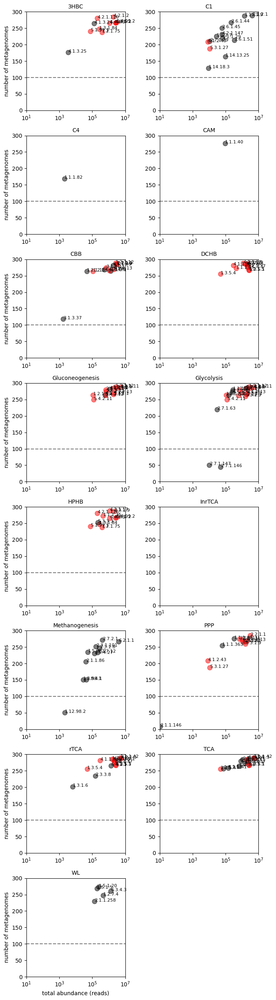

In [4]:
# Merge ecdata with pathways_df based on EC numbers
merged_df = pd.merge(pathways_df, ecdata, left_on='EC', right_index=True, how='right')

# Group by pathways
grouped_pathways = merged_df.groupby('pathway')

# Check if any EC is in more than one pathway
ec_in_multiple_pathways = pathways_df.groupby('EC').filter(lambda x: len(x) > 1)['EC'].unique()

fig, axes = plt.subplots(8, 2, figsize=(7, 25)) 
axes = axes.flatten()  # Flatten the axes array for easy iteration

# Get all pathways
all_pathways = pathways_df['pathway'].unique()

# Loop through each pathway (including empty pathways) and create the plot
for idx, (ax, pathway) in enumerate(zip(axes, all_pathways)):
    if pathway in grouped_pathways.groups:
        group = grouped_pathways.get_group(pathway)

        # Drop 'pathway' and 'EC' columns to get only abundance data
        abundance_data = group.drop(columns=['pathway', 'EC'])

        # Ensure only numeric columns are selected (abundance data should be numeric)
        abundance_data = abundance_data.apply(pd.to_numeric, errors='coerce')

        # Calculate the prevalence (number of metagenomes where abundance > 0) for each EC number
        prevalence = (abundance_data > 0).sum(axis=1)

        # Calculate the total abundance for each EC number
        total_abundance = abundance_data.sum(axis=1)

        # Plotting with special color for EC numbers in multiple pathways
        colors = ['red' if ec in ec_in_multiple_pathways else 'black' for ec in group['EC']]
        ax.scatter(total_abundance, prevalence, color=colors, alpha=0.5, s=70)

        ax.axhline(y=100, color='gray', linestyle='--')

        # Add EC numbers as text labels next to each point
        for i, ec_number in enumerate(group['EC']):
            ax.text(total_abundance.iloc[i], prevalence.iloc[i], ec_number, fontsize=8)

    ax.set_title(f'{pathway}', fontsize=10)
    ax.grid(False)
    ax.set_xscale('log')
    ax.set_xlim(10, 10**7)
    ax.set_ylim(0, 300)

    # Set labels for only the outermost plots
    if idx % 2 == 0:  # First column
        ax.set_ylabel('number of metagenomes')
    if idx >= 14:  # Last row
        ax.set_xlabel('total abundance (reads)')

# Add empty plots if needed for pathways without EC numbers in the OTU table
for i in range(len(all_pathways), len(axes)):
    axes[i].axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()
#plt.savefig('prevalence_anal_total.png', dpi=300)

plt.show()


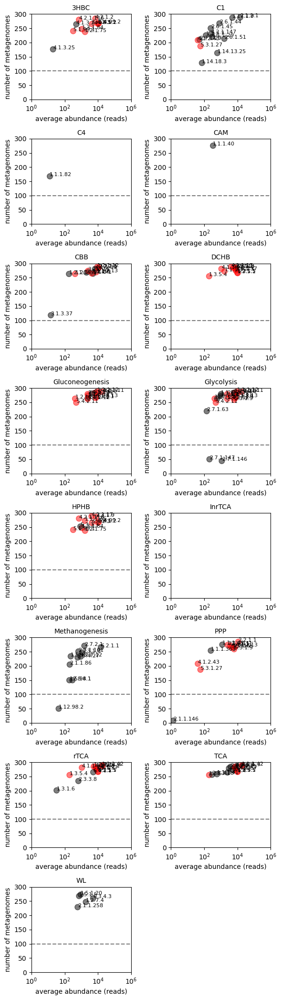

In [5]:
# Merge ecdata with pathways_df based on EC numbers
merged_df = pd.merge(pathways_df, ecdata, left_on='EC', right_index=True, how='right')

# Group by pathways
grouped_pathways = merged_df.groupby('pathway')

# Check if any EC is in more than one pathway
ec_in_multiple_pathways = pathways_df.groupby('EC').filter(lambda x: len(x) > 1)['EC'].unique()

# Set up a 7x2 grid for the subplots
fig, axes = plt.subplots(8, 2, figsize=(6, 21))  # 7 rows, 2 columns
axes = axes.flatten()  # Flatten the axes array for easy iteration

# Get all pathways
all_pathways = pathways_df['pathway'].unique()

# Loop through each pathway (including empty pathways) and create the plot
for ax, pathway in zip(axes, all_pathways):
    if pathway in grouped_pathways.groups:
        group = grouped_pathways.get_group(pathway)

        # Drop 'pathway' and 'EC' columns to get only abundance data
        abundance_data = group.drop(columns=['pathway', 'EC'])

        # Ensure only numeric columns are selected (abundance data should be numeric)
        abundance_data = abundance_data.apply(pd.to_numeric, errors='coerce')

        # Calculate the prevalence (number of metagenomes where abundance > 0) for each EC number
        prevalence = (abundance_data > 0).sum(axis=1)

        # Calculate the total abundance for each EC number
        total_abundance = abundance_data.mean(axis=1)

        # Plotting with special color for EC numbers in multiple pathways
        colors = ['red' if ec in ec_in_multiple_pathways else 'black' for ec in group['EC']]
        ax.scatter(total_abundance, prevalence, color=colors, alpha = .5, s=70)

        ax.axhline(y=100, color='gray', linestyle='--')

        # Add EC numbers as text labels next to each point
        for i, ec_number in enumerate(group['EC']):
            ax.text(total_abundance.iloc[i], prevalence.iloc[i], ec_number, fontsize=8)

    ax.set_title(f'{pathway}', fontsize=10)
    ax.grid(False)
    ax.set_xscale('log')
    ax.set_xlim(1, 10**6)
    ax.set_ylim(0, 300)

    # Set labels for only the outermost plots
    if idx % 2 == 0:  # First column
        ax.set_ylabel('number of metagenomes')
    if idx >= 14:  # Last row
        ax.set_xlabel('average abundance (reads)')

# Add empty plots if needed for pathways without EC numbers in the OTU table
for i in range(len(all_pathways), len(axes)):
    axes[i].axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()
#plt.savefig('prevalence_anal_avg.png', dpi=300)

plt.show()


Clean dataset

In [6]:
#Identified by Deborah
ecdata = ecdata.drop(ecdata.columns[[124, 122, 148, 152, 150, 139, 140, 141, 142, 143, 144, 153, 137, 138, 133, 134, 64, 76, 72, 77, 174, 175, 198, 176, 173, 232, 233, 231, 69, 67, 76, 71]], axis=1)

#Identified by me
ecdata = ecdata.drop(columns=['SAMN10130915']) #weird metagenome: Contains only a few EC

Repeat prevalence analysis

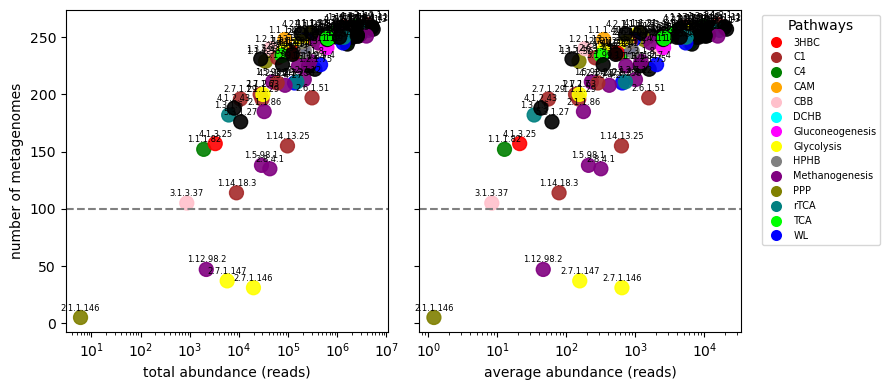

In [7]:
tested_df = ecdata.loc[ecdata.index.isin(ec_list)]

# Calculate prevalence
prevalence = (tested_df > 0).sum(axis=1)

# Calculate average and sum of abundances
filtered_ecdata = tested_df[tested_df > 0]
average_abundance = filtered_ecdata.sum(axis=1) / filtered_ecdata.count(axis=1)
sum_abundance = filtered_ecdata.sum(axis=1)

# Define a specific color for each pathway
pathway_colors = {
    '3HBC': 'red',
    'C1': 'brown',
    'C4': 'green',
    'CAM': 'orange',
    'CBB': 'pink',
    'DCHB': 'cyan',
    'Gluconeogenesis': 'magenta',
    'Glycolysis': 'yellow',
    'HPHB': 'gray',
    'Methanogenesis': 'purple',
    'PPP': 'olive',
    'rTCA': 'teal',
    'TCA': 'lime',
    'WL': 'blue'
}

# Create a dictionary to map EC numbers to colors
ec_to_pathway = pathways_df.groupby('EC')['pathway'].apply(lambda x: '/'.join(x))
ec_to_color = {ec: 'black' if len(pathways.split('/')) > 1 else pathway_colors.get(pathways.split('/')[0], 'black')
               for ec, pathways in ec_to_pathway.items()}

# Map EC numbers to colors
colors = [ec_to_color.get(ec, 'black') for ec in tested_df.index]

# Create the figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Plot 1: Average abundance
scatter1 = ax1.scatter(sum_abundance, prevalence, c=colors, alpha=.9, s=100)
ax1.axhline(y=100, color='gray', linestyle='--')
ax1.set_xlabel('total abundance (reads)')
ax1.set_xscale('log')
ax1.set_ylabel('number of metagenomes')

# Plot 2: Sum of abundances
scatter2 = ax2.scatter(average_abundance, prevalence, c=colors, alpha=.9, s=100)
ax2.axhline(y=100, color='gray', linestyle='--')
ax2.set_xlabel('average abundance (reads)')
ax2.set_xscale('log')
ax2.set_yticklabels([])
#ax2.set_ylabel('number of metagenomes')

# Add legend to the second plot
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=9, linestyle='') 
           for color in pathway_colors.values()]
ax2.legend(handles, pathway_colors.keys(), title='Pathways', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=7)

# Annotate dots with EC numbers on both plots
for i, (x, y, ec) in enumerate(zip(sum_abundance, prevalence, tested_df.index)):
    ax1.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

for i, (x, y, ec) in enumerate(zip(average_abundance, prevalence, tested_df.index)):
    ax2.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)


plt.tight_layout()
plt.show()


In [8]:
#fill NaN values with 0
ecdata = ecdata.fillna(0)


In [9]:
ecdata

,CR18BCF,BQ170218F,BQ170218S,BQ170218,BR170218_2F,BR170218_1,BR170218_2S,CR18BSF,CR18CHF,CR18CHS,...,SAMN14653546,SAMN14653547,SAMN14653548,SAMN14653549,SAMN14653552,SAMN14653553,SAMN14653554,SAMN14653555,SAMN14653556,SAMN14653557
EC,,,,,,,,,,,,,,,,,,,,,
1.1.1.1,1175.0,8191.0,8848.0,7199.0,4631.0,1511.0,1547.0,13016.0,1548.0,1085.0,...,1967.0,1125.0,799.0,4804.0,1395.0,407.0,491.0,1088.0,1960.0,567.0
1.1.1.10,17.0,0.0,0.0,0.0,6.0,9.0,41.0,103.0,39.0,24.0,...,40.0,24.0,25.0,9.0,28.0,1.0,5.0,39.0,44.0,7.0
1.1.1.100,6054.0,4291.0,5304.0,3802.0,10787.0,11054.0,13673.0,26515.0,9391.0,7281.0,...,12076.0,6783.0,4983.0,9983.0,6694.0,2111.0,11532.0,9093.0,8131.0,4254.0
1.1.1.103,1660.0,30.0,669.0,36.0,1607.0,1962.0,3418.0,4539.0,1516.0,1672.0,...,2533.0,1344.0,1234.0,390.0,991.0,975.0,356.0,3007.0,1561.0,931.0
1.1.1.107,52.0,144.0,136.0,209.0,42.0,104.0,150.0,101.0,130.0,94.0,...,77.0,112.0,60.0,27.0,68.0,8.0,19.0,162.0,75.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7.5.2.8,486.0,0.0,87.0,0.0,412.0,31.0,144.0,2940.0,956.0,146.0,...,394.0,295.0,331.0,94.0,186.0,23.0,81.0,287.0,451.0,269.0
7.6.2.1,785.0,26.0,121.0,10.0,481.0,511.0,804.0,907.0,409.0,353.0,...,655.0,389.0,349.0,360.0,420.0,88.0,231.0,553.0,383.0,179.0
7.6.2.2,1264.0,559.0,784.0,415.0,1219.0,1320.0,2076.0,3377.0,1668.0,1251.0,...,2576.0,998.0,871.0,512.0,998.0,354.0,1655.0,1659.0,1267.0,516.0


In [10]:
#Filter only C genes from the begining 
#ecdata = ecdata.loc[ecdata.index.isin(ec_list)]
#ecdata = ecdata.loc[ecdata.index.isin(ec_c_fixation_list)]

Normalization

In [11]:
#Normalization by col_sum
ecdata_n = ecdata.apply(lambda x: (x / x.sum(skipna=True)), axis=0)

# Remove columns where ecdata.loc["2.7.7.6"] == 0 (these ones had NaN for rpo...)
ecdata_with_rpo = ecdata.loc[:, ecdata.loc["2.7.7.6"] != 0]
ecdata_n_rpo = ecdata_with_rpo.div(ecdata_with_rpo.loc["2.7.7.6"], axis=1)


Select only carbon associated genes

In [78]:

dataset_carbon = ecdata.loc[ecdata.index.isin(ec_list)]
dataset_carbon_n = ecdata_n.loc[ecdata_n.index.isin(ec_list)]
dataset_carbon_n_rpo = ecdata_n_rpo.loc[ecdata_n_rpo.index.isin(ec_list)]

# Select only carbon fixation pathways genes
#dataset_carbon = ecdata.loc[ecdata.index.isin(ec_c_fixation_list)]
#dataset_carbon_n = ecdata_n.loc[ecdata_n.index.isin(ec_c_fixation_list)]
#dataset_carbon_n_rpo = ecdata_n_rpo.loc[ecdata_n_rpo.index.isin(ec_c_fixation_list)]


In [13]:
dataset_carbon

,CR18BCF,BQ170218F,BQ170218S,BQ170218,BR170218_2F,BR170218_1,BR170218_2S,CR18BSF,CR18CHF,CR18CHS,...,SAMN14653546,SAMN14653547,SAMN14653548,SAMN14653549,SAMN14653552,SAMN14653553,SAMN14653554,SAMN14653555,SAMN14653556,SAMN14653557
EC,,,,,,,,,,,,,,,,,,,,,
1.1.1.27,616.0,37.0,208.0,22.0,597.0,1279.0,1309.0,3605.0,488.0,536.0,...,323.0,393.0,508.0,94.0,595.0,187.0,109.0,769.0,507.0,633.0
1.1.1.29,23.0,1.0,1.0,0.0,17.0,3.0,44.0,17.0,137.0,76.0,...,27.0,9.0,15.0,5.0,12.0,0.0,16.0,28.0,20.0,1.0
1.1.1.35,994.0,558.0,842.0,612.0,1914.0,897.0,1995.0,4896.0,2035.0,931.0,...,2742.0,1054.0,855.0,1878.0,1221.0,254.0,7735.0,1242.0,1650.0,548.0
1.1.1.363,46.0,2.0,13.0,0.0,23.0,51.0,38.0,120.0,73.0,74.0,...,49.0,65.0,39.0,20.0,77.0,15.0,75.0,26.0,76.0,43.0
1.1.1.37,4027.0,7155.0,6762.0,5724.0,5365.0,6314.0,9344.0,11661.0,4810.0,3906.0,...,8695.0,3755.0,3179.0,3790.0,4093.0,1709.0,5281.0,5981.0,4836.0,4541.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6.2.1.5,4693.0,6850.0,7074.0,6046.0,7606.0,4777.0,8920.0,17936.0,7470.0,4702.0,...,9366.0,4191.0,3406.0,6739.0,3644.0,1355.0,6830.0,6344.0,5476.0,6044.0
6.3.4.3,3869.0,13.0,895.0,26.0,2936.0,4853.0,8346.0,7493.0,3620.0,3173.0,...,4027.0,4359.0,3452.0,1022.0,3156.0,1426.0,970.0,7820.0,2907.0,2338.0
6.4.1.1,4133.0,20.0,598.0,3.0,3865.0,3191.0,5132.0,12973.0,4806.0,1741.0,...,3509.0,1716.0,1598.0,1827.0,2094.0,720.0,882.0,2917.0,3143.0,2465.0


Delete EC identified in the prevalence analysis

In [79]:
# List of indexes to remove
indexes_to_remove = ["2.7.1.146", "2.7.1.147", "1.12.98.2", "2.1.1.146"]

# Remove the rows with the specified indexes
dataset_carbon = dataset_carbon.drop(index=indexes_to_remove)
dataset_carbon_n = dataset_carbon_n.drop(index=indexes_to_remove)
dataset_carbon_n_rpo = dataset_carbon_n_rpo.drop(index=indexes_to_remove)


KeyError: "['2.7.1.146', '2.7.1.147', '1.12.98.2', '2.1.1.146'] not found in axis"

Repeat prevalence analysis (for all 3 datasets)

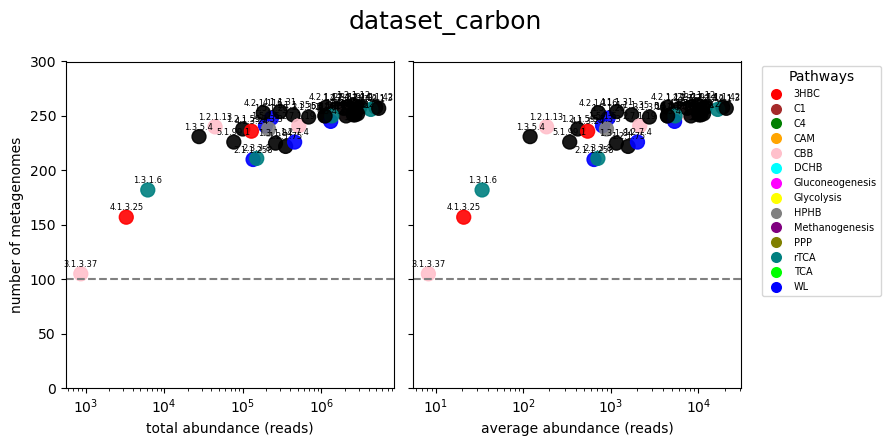

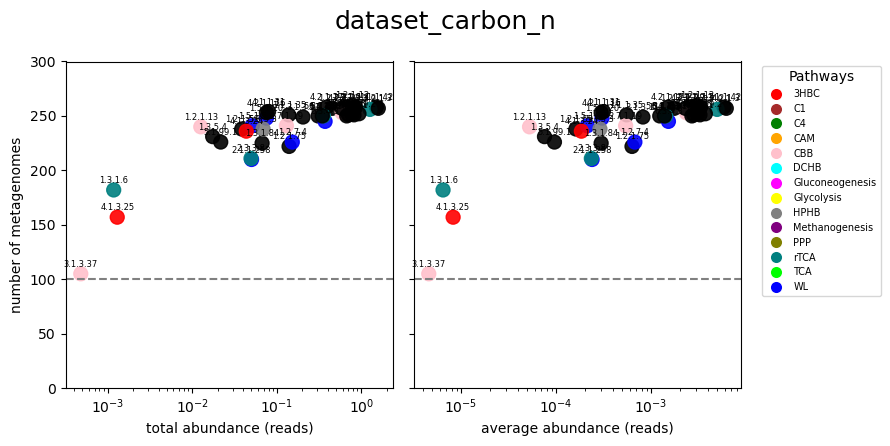

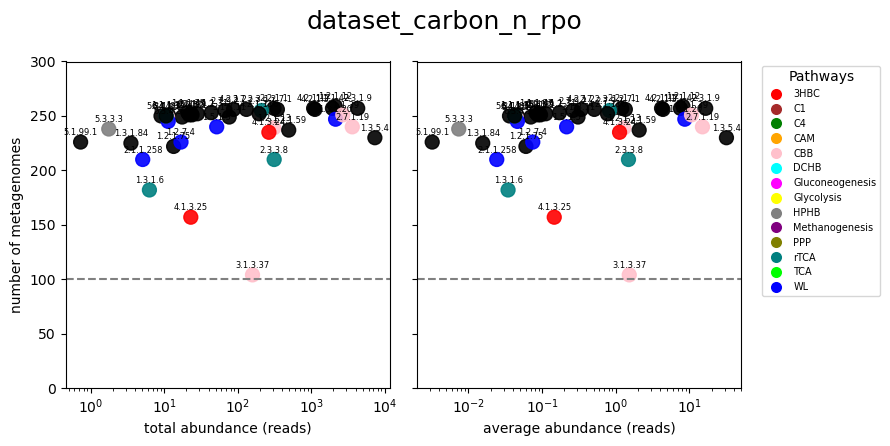

In [80]:
dataset_names = ['dataset_carbon', 'dataset_carbon_n', 'dataset_carbon_n_rpo']

# Loop through the datasets along with their names
for tested_df, dataset_name in zip([dataset_carbon, dataset_carbon_n, dataset_carbon_n_rpo], dataset_names):

    # Calculate prevalence
    prevalence = (tested_df > 0).sum(axis=1)

    # Calculate average and sum of abundances
    filtered_ecdata = tested_df[tested_df > 0]
    average_abundance = filtered_ecdata.sum(axis=1) / filtered_ecdata.count(axis=1)
    sum_abundance = filtered_ecdata.sum(axis=1)

    # Define a specific color for each pathway
    pathway_colors = {
        '3HBC': 'red',
        'C1': 'brown',
        'C4': 'green',
        'CAM': 'orange',
        'CBB': 'pink',
        'DCHB': 'cyan',
        'Gluconeogenesis': 'magenta',
        'Glycolysis': 'yellow',
        'HPHB': 'gray',
        'Methanogenesis': 'purple',
        'PPP': 'olive',
        'rTCA': 'teal',
        'TCA': 'lime',
        'WL': 'blue'
    }

    # Create a dictionary to map EC numbers to colors
    ec_to_pathway = pathways_df.groupby('EC')['pathway'].apply(lambda x: '/'.join(x))
    ec_to_color = {ec: 'black' if len(pathways.split('/')) > 1 else pathway_colors.get(pathways.split('/')[0], 'black')
                for ec, pathways in ec_to_pathway.items()}

    # Map EC numbers to colors
    colors = [ec_to_color.get(ec, 'black') for ec in tested_df.index]

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4.5))

    # Plot 1: Average abundance
    scatter1 = ax1.scatter(sum_abundance, prevalence, c=colors, alpha=.9, s=100)
    ax1.axhline(y=100, color='gray', linestyle='--')
    ax1.set_xlabel('total abundance (reads)')
    ax1.set_xscale('log')
    ax1.set_ylabel('number of metagenomes')

    # Plot 2: Sum of abundances
    scatter2 = ax2.scatter(average_abundance, prevalence, c=colors, alpha=.9, s=100)
    ax2.axhline(y=100, color='gray', linestyle='--')
    ax2.set_xlabel('average abundance (reads)')
    ax2.set_xscale('log')
    ax2.set_yticklabels([])
    #ax2.set_ylabel('number of metagenomes')
    ax1.set_ylim(0, 300)
    ax2.set_ylim(0, 300)

    # Add legend to the second plot
    handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=9, linestyle='') 
            for color in pathway_colors.values()]
    ax2.legend(handles, pathway_colors.keys(), title='Pathways', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=7)

    # Annotate dots with EC numbers on both plots
    for i, (x, y, ec) in enumerate(zip(sum_abundance, prevalence, tested_df.index)):
        ax1.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

    for i, (x, y, ec) in enumerate(zip(average_abundance, prevalence, tested_df.index)):
        ax2.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)
    
    fig.suptitle(f"{dataset_name}", fontsize=18)

    plt.tight_layout()
    plt.show()


Prepare the matrix

In [19]:
dataset_complete



,CR18BCF,BQ170218F,BQ170218S,BQ170218,BR170218_2F,BR170218_1,BR170218_2S,CR18BSF,CR18CHF,CR18CHS,...,SAMN14653546,SAMN14653547,SAMN14653548,SAMN14653549,SAMN14653552,SAMN14653553,SAMN14653554,SAMN14653555,SAMN14653556,SAMN14653557
EC,,,,,,,,,,,,,,,,,,,,,
1.1.1.27,0.000311,3.283504e-05,1.548771e-04,0.000023,0.000232,0.000574,0.000391,0.000648,0.000211,0.000332,...,0.000100,0.000260,0.000402,0.000053,0.000430,0.000303,0.000040,0.000286,0.000266,4.026241e-04
1.1.1.29,0.000012,8.874335e-07,7.446016e-07,0.000000,0.000007,0.000001,0.000013,0.000003,0.000059,0.000047,...,0.000008,0.000006,0.000012,0.000003,0.000009,0.000000,0.000006,0.000010,0.000011,6.360571e-07
1.1.1.35,0.000503,4.951879e-04,6.269546e-04,0.000628,0.000744,0.000403,0.000596,0.000881,0.000882,0.000576,...,0.000850,0.000697,0.000677,0.001052,0.000883,0.000412,0.002828,0.000461,0.000867,3.485593e-04
1.1.1.363,0.000023,1.774867e-06,9.679821e-06,0.000000,0.000009,0.000023,0.000011,0.000022,0.000032,0.000046,...,0.000015,0.000043,0.000031,0.000011,0.000056,0.000024,0.000027,0.000010,0.000040,2.735045e-05
1.1.1.37,0.002036,6.349587e-03,5.034996e-03,0.005870,0.002086,0.002836,0.002791,0.002097,0.002084,0.002417,...,0.002694,0.002484,0.002518,0.002123,0.002961,0.002770,0.001931,0.002222,0.002541,2.888335e-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6.2.1.5,0.002373,6.078919e-03,5.267312e-03,0.006200,0.002957,0.002146,0.002664,0.003226,0.003237,0.002910,...,0.002902,0.002772,0.002698,0.003776,0.002636,0.002196,0.002497,0.002356,0.002877,3.844329e-03
6.3.4.3,0.001956,1.153664e-05,6.664185e-04,0.000027,0.001141,0.002180,0.002493,0.001348,0.001569,0.001964,...,0.001248,0.002883,0.002734,0.000573,0.002283,0.002311,0.000355,0.002905,0.001527,1.487101e-03
6.4.1.1,0.002090,1.774867e-05,4.452718e-04,0.000003,0.001503,0.001433,0.001533,0.002333,0.002083,0.001077,...,0.001087,0.001135,0.001266,0.001024,0.001515,0.001167,0.000322,0.001084,0.001651,1.567881e-03


['sediment' 'fluid' 'rock' nan 'biofilm'] 

['Argentina' 'Chile' 'Costa_Rica' 'Panama' 'Italy' 'Iceland'
 'Southern_Mariana_Trough' 'Japan' 'Utah' 'Taiwan' 'Galicia' 'Lau_Basin'
 'YunNA province' 'Central_India' 'YNP' 'Loihi_Seamount' 'South_Africa'
 'California' 'Nevada' 'Aegean_sea' 'Canada' 'Kamchatka'
 'Southwest_Indian_Ridge' 'South-mid_Atlantic_Ridge' 'Main_Endeavor_Field'
 'Himalayas' 'Guanacaste_region' 'Nicoya' 'Central_Cordillera'] 

['spring' 'vent' 'volcanic_lake'] 

['ARG19' 'CH20' 'CR17' 'CR18' 'CR19' 'FENIX21' 'ICE21' 'NCBI'] 



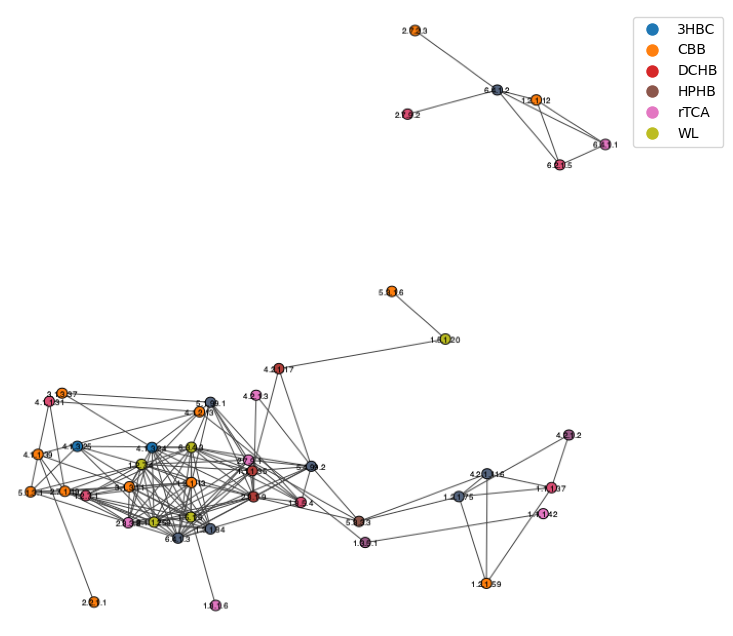

In [84]:
envdata = pd.read_csv("env.csv", index_col="rowname")

print(envdata.sample_type.unique(), "\n")
print(envdata.location3.unique(), "\n")
print(envdata.geotype1.unique(), "\n")
print(envdata.campaign.unique(), "\n")

# Get the indexes of samples to select
selected_samples = envdata[envdata.campaign == 'ARG19'].index.tolist()
#['ARG19' 'CH20' 'CR17' 'CR18' 'CR19' 'FENIX21' 'ICE21' 'NCBI'] 
# Select all columns from dataset_complete that are in the list of indexes
selection = dataset_carbon_n[selected_samples]


dataset_complete = dataset_carbon_n #.dropna(axis=1, how='any') #because we have some missing data
#dataset_complete.index.name = None


correlation_matrix = selection.T.corr(method='spearman')
correlation_matrix[correlation_matrix < 0.5] = 0

# Create the graph from the matrix
bac_cor_ig = ig.Graph.Adjacency((correlation_matrix.values > 0).tolist(), mode="undirected")
bac_cor_ig.es['weight'] = correlation_matrix.values[correlation_matrix.values > 0]

# Simplify the graph to remove loops and multiple edges
bac_cor_ig = bac_cor_ig.simplify()

# Plot the graph
random.seed(200)
#layout = bac_cor_ig.layout_sugiyama()
layout = bac_cor_ig.layout_kamada_kawai() #g spring embedded
#layout = bac_cor_ig.layout_reingold_tilford()
# Create a dictionary mapping EC numbers to pathways
ec_to_pathways = ec_c_fixation_df.groupby('EC')['pathway'].apply(list).to_dict()

possible_pathways = ['3HBC', 'CBB', 'DCHB', 'HPHB', 'rTCA', 'WL']

# Use a specific colormap for distinct colors
cmap = plt.get_cmap('tab10')
color_map = {pathway: cmap(i / len(possible_pathways)) for i, pathway in enumerate(possible_pathways)}


# Function to mix colors if an EC number is associated with multiple pathways
def mix_colors(colors):
    return tuple(sum(x) / len(x) for x in zip(*colors))

# Assign colors to vertices based on their associated pathways
vertex_colors = []
for ec in correlation_matrix.index:
    if ec in ec_to_pathways:
        pathways = ec_to_pathways[ec]
        if len(pathways) > 1:
            mixed_color = mix_colors([color_map[path] for path in pathways])
            vertex_colors.append(mcolors.to_hex(mixed_color))
        else:
            vertex_colors.append(mcolors.to_hex(color_map[pathways[0]]))
    else:
        vertex_colors.append("white")  # Default to black if no pathway is found

# Set the vertex colors
bac_cor_ig.vs['color'] = vertex_colors

random.seed(2)
# Plot using the explicit layout
ig.plot(
    bac_cor_ig, 
    layout=layout, 
    vertex_size=10, 
    bbox=(600, 600), 
    vertex_label=correlation_matrix.index, 
    vertex_label_size=8, 
    target="/tmp/graph_plot.png"  # Save plot to this path
)

# Load the graph plot image
graph_img = Image.open("/tmp/graph_plot.png")

# Plot the graph image and the legend together
fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(graph_img)
ax.axis('off')  # Turn off the axis

# Create a legend using matplotlib
legend_elements = [Line2D([0], [0], marker='o', color='w', label=pathway, 
                          markerfacecolor=mcolors.to_hex(color_map[pathway]), markersize=10)
                   for pathway in possible_pathways]

# Add the legend
ax.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1, 1))

plt.savefig("throw.pdf", format="pdf")

plt.show()

In [74]:
envdata = pd.read_csv("env.csv", index_col="rowname")

print(envdata.sample_type.unique(), "\n")
print(envdata.location3.unique(), "\n")
print(envdata.geotype1.unique(), "\n")
print(envdata.campaign.unique(), "\n")

# Get the indexes of samples to select
selected_samples = envdata[envdata.campaign == 'CH20'].index.tolist()

# Select all columns from dataset_complete that are in the list of indexes
selection = dataset_carbon_n[selected_samples]
selection

['sediment' 'fluid' 'rock' nan 'biofilm'] 

['Argentina' 'Chile' 'Costa_Rica' 'Panama' 'Italy' 'Iceland'
 'Southern_Mariana_Trough' 'Japan' 'Utah' 'Taiwan' 'Galicia' 'Lau_Basin'
 'YunNA province' 'Central_India' 'YNP' 'Loihi_Seamount' 'South_Africa'
 'California' 'Nevada' 'Aegean_sea' 'Canada' 'Kamchatka'
 'Southwest_Indian_Ridge' 'South-mid_Atlantic_Ridge' 'Main_Endeavor_Field'
 'Himalayas' 'Guanacaste_region' 'Nicoya' 'Central_Cordillera'] 

['spring' 'vent' 'volcanic_lake'] 

['ARG19' 'CH20' 'CR17' 'CR18' 'CR19' 'FENIX21' 'ICE21' 'NCBI'] 



,AU200310F,AU200310S,BM200304F,BM200304S,CP200307F,CQ200302F,CR200310F,CT200308F,EM200307F,EM200307S,GS200305F,PM200308F,PM200308S,SP200306F,SP200306S,TF200303F,TF200303S,TP200304F
EC,,,,,,,,,,,,,,,,,,
1.1.1.27,0.000138,0.000228,0.000152,0.000337,0.000133,4.740834e-06,0.000109,0.000086,0.000233,0.000120,0.000045,8.256611e-06,0.000156,0.000194,0.000191,0.000229,0.000342,0.000155
1.1.1.29,0.000000,0.000010,0.000019,0.000063,0.000006,0.000000e+00,0.000114,0.000010,0.000001,0.000021,0.000003,5.897579e-07,0.000000,0.000005,0.000010,0.000003,0.000000,0.000027
1.1.1.35,0.001228,0.001025,0.000541,0.000737,0.000241,1.314791e-03,0.000788,0.000692,0.000793,0.000929,0.001045,2.418007e-05,0.000454,0.000263,0.000849,0.000542,0.000477,0.000603
1.1.1.363,0.000022,0.000024,0.000023,0.000041,0.000018,7.901391e-07,0.000015,0.000024,0.000031,0.000014,0.000049,1.769274e-06,0.000013,0.000028,0.000035,0.000007,0.000007,0.000043
1.1.1.37,0.002275,0.002265,0.002184,0.002393,0.002551,2.394121e-03,0.002942,0.001884,0.002874,0.003160,0.001522,1.055667e-04,0.002554,0.002103,0.002970,0.003667,0.003077,0.002091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6.2.1.5,0.002932,0.002783,0.003589,0.003658,0.001960,1.852876e-03,0.003048,0.002484,0.002847,0.002736,0.003281,3.785656e-03,0.002360,0.002298,0.002898,0.002279,0.002507,0.003007
6.3.4.3,0.001030,0.001467,0.000876,0.002868,0.001116,3.397598e-05,0.001260,0.001226,0.001483,0.002595,0.001869,1.120540e-04,0.002036,0.001620,0.002315,0.001297,0.002417,0.002311
6.4.1.1,0.001560,0.001785,0.001503,0.004715,0.001110,2.765487e-05,0.001232,0.003302,0.001221,0.001157,0.002355,1.580551e-04,0.002074,0.001302,0.001389,0.001062,0.001792,0.001469


In [75]:
dataset_complete = dataset_carbon_n #.dropna(axis=1, how='any') #because we have some missing data
#dataset_complete.index.name = None


correlation_matrix = selection.T.corr(method='spearman')
correlation_matrix[correlation_matrix < 0.6] = 0

Plot with igraph

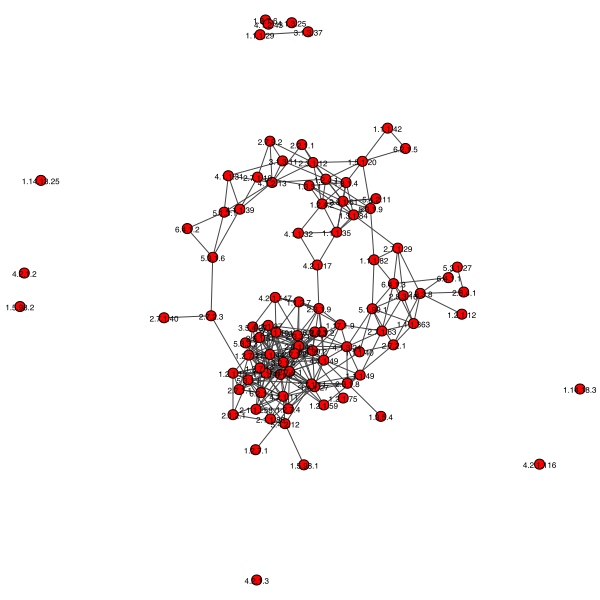

In [70]:
# Create the graph from the matrix
bac_cor_ig = ig.Graph.Adjacency((correlation_matrix.values > 0).tolist(), mode="undirected")
bac_cor_ig.es['weight'] = correlation_matrix.values[correlation_matrix.values > 0]

# Simplify the graph to remove loops and multiple edges
bac_cor_ig = bac_cor_ig.simplify()

# Plot the graph
random.seed(200)
#layout = bac_cor_ig.layout_sugiyama()
layout = bac_cor_ig.layout_kamada_kawai() #g spring embedded
#layout = bac_cor_ig.layout_reingold_tilford()
ig.plot(bac_cor_ig, layout=layout, vertex_size=10, bbox=(600, 600), vertex_label=correlation_matrix.index, vertex_label_size=8, target="graph_plot.pdf")
#ig.plot(bac_cor_ig, vertex_size=10, bbox=(600, 600), vertex_label=correlation_matrix.index, vertex_label_size=8, target="graph_plot.pdf")


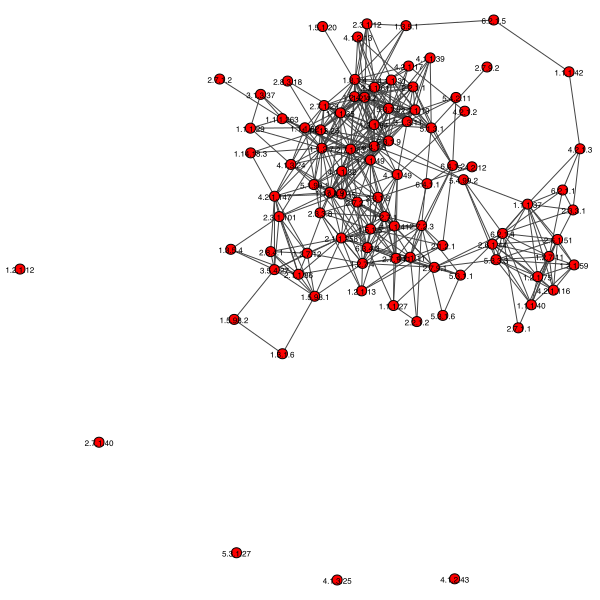

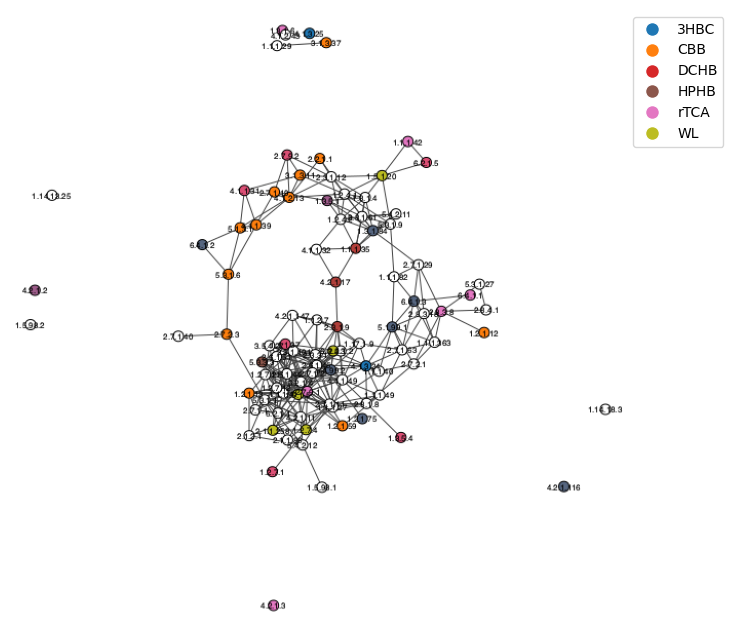

In [71]:

# Create a dictionary mapping EC numbers to pathways
ec_to_pathways = ec_c_fixation_df.groupby('EC')['pathway'].apply(list).to_dict()

# Define the list of possible pathways
#possible_pathways = ['3HBC', 'C1', 'C4', 'CAM', 'CBB', 'DCHB', 'Gluconeogenesis',
 #                    'Glycolysis', 'HPHB', 'InrTCA', 'Methanogenesis', 'PPP', 'rTCA',
 #                    'TCA', 'WL']
possible_pathways = ['3HBC', 'CBB', 'DCHB', 'HPHB', 'rTCA', 'WL']

# Use a specific colormap for distinct colors
cmap = plt.get_cmap('tab10')
color_map = {pathway: cmap(i / len(possible_pathways)) for i, pathway in enumerate(possible_pathways)}


# Function to mix colors if an EC number is associated with multiple pathways
def mix_colors(colors):
    return tuple(sum(x) / len(x) for x in zip(*colors))

# Assign colors to vertices based on their associated pathways
vertex_colors = []
for ec in correlation_matrix.index:
    if ec in ec_to_pathways:
        pathways = ec_to_pathways[ec]
        if len(pathways) > 1:
            mixed_color = mix_colors([color_map[path] for path in pathways])
            vertex_colors.append(mcolors.to_hex(mixed_color))
        else:
            vertex_colors.append(mcolors.to_hex(color_map[pathways[0]]))
    else:
        vertex_colors.append("white")  # Default to black if no pathway is found

# Set the vertex colors
bac_cor_ig.vs['color'] = vertex_colors

random.seed(2)
# Plot using the explicit layout
ig.plot(
    bac_cor_ig, 
    layout=layout, 
    vertex_size=10, 
    bbox=(600, 600), 
    vertex_label=correlation_matrix.index, 
    vertex_label_size=8, 
    target="/tmp/graph_plot.png"  # Save plot to this path
)

# Load the graph plot image
graph_img = Image.open("/tmp/graph_plot.png")

# Plot the graph image and the legend together
fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(graph_img)
ax.axis('off')  # Turn off the axis

# Create a legend using matplotlib
legend_elements = [Line2D([0], [0], marker='o', color='w', label=pathway, 
                          markerfacecolor=mcolors.to_hex(color_map[pathway]), markersize=10)
                   for pathway in possible_pathways]

# Add the legend
ax.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1, 1))

#plt.savefig("graph_with_legend.pdf", format="pdf")

plt.show()


## Testing representative genes against the environmental parameters

In [139]:

## CBB
prk = "2.7.1.19"
rbc = "4.1.1.39"

gapn = "1.2.1.13" # according to KEGG is exclusive... and appear also high in plot #I checked and it seems indeed to be exclusive #and it is different to gapdh
sbpase = "3.1.3.37" #according to KEGG is exclusive... but appear low in the plot!!! #I checked and it seems indeed to be exclusive

## some also appears highly in correlation with these 2
#(pgk = "2.7.2.3" according to plot BUT also in other pathways... (only NGG?))
#(tkt = "2.2.1.1" according to plot BUT also in other pathways...)
#(fbp = "3.1.3.11" according to plot BUT also in other pathways...)
#(rpi = "5.3.1.6" according to plot BUT also in other pathways...)
#(fba = "4.1.2.13" according to plot BUT also in other pathways...)
#(gapdh = "1.2.1.12" according to plot BUT also in other pathways...)

#(rpe = "5.1.3.1" according to KEGG is exclusive... and appear also high in plot #I checked and IT IS WRONG: IT ALSO APPEARS IN PPP for KEGG so I think we did a mistake when filling the excel sheet)

CBB = dataset_carbon.loc[dataset_carbon.index.isin([prk, rbc])]
CBB_2 = dataset_carbon.loc[dataset_carbon.index.isin([prk, rbc, gapn])]
CBB_3 = dataset_carbon.loc[dataset_carbon.index.isin([prk, rbc, gapn, sbpase])]

col_sums_CBB = CBB.sum(axis=0)
col_sums_CBB_2 = CBB_2.sum(axis=0)
col_sums_CBB_3 = CBB_3.sum(axis=0)



## rTCA  

#TCA -> rTCA
# citrate synthase (2.3.3.1) -> citrate lyase (2.3.3.8) (specific of rTCA vs TCA BUT present in other ones [not so sure actually]) 
#                               (or also citryl-CoA lyase (4.1.3.34) + citryl-CoA synthetase (6.2.1.18))
# succinate dehydrogenase (1.3.99.1?? OBSOLETE! NOW 1.3.5.1) -> fumarate reductase (1.3.5.4 BUT also present in anaerobic resp) 
#                                                               (also 1.3.1.6 according to EC list? - and this one is exclusive!)
# α-ketoglutarate dehydrogenase (1.2.4.2) -> α-ketoglutarate synthase (1.2.7.3 - but present in BOTH TCA and rTCA?!)


acly = "2.3.3.8" # according to Fullerton
# ccl = "4.1.3.34" # according to above # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
# ccs = "6.2.1.18" # according to above # FOUND IN FULLERTON BUT NOT IN DEBORAH'S

frd = "1.3.5.1" #according to Simkus (but also in the TCA cycle)
frd2 = "1.3.1.6" # according to above seems more exclusive than 1.3.5.1

# kor = "1.2.7.3" # according to above but present in BOTH TCA and rTCA?! # FOUND IN FULLERTON BUT NOT IN DEBORAH'S

#FROM THE PLOT
#(suc = "6.2.1.5" according to plot BUT also in many other pathways...)
#(idh = "1.1.1.42" according to plot BUT also in other pathways...)
#(aco = "4.2.1.3" according to plot BUT also in many other pathways...)
#(mdh = "1.1.1.37" according to plot BUT also in many other pathways...)
#(por = "1.2.7.1" according to plot BUT also in other pathways...) (and it is a bad one i think)
#(ppdk = "2.7.9.1" according to plot BUT also in other pathways...) (and it is a bad one i think)
#(pyc = "6.4.1.1" according to plot BUT also in other pathways...)
#(ppsA = "2.7.9.2" according to plot BUT also in other pathways...)


#4.2.1.2 is bad

rTCA = dataset_carbon.loc[dataset_carbon.index.isin([acly, frd2])]
rTCA_2 = dataset_carbon.loc[dataset_carbon.index.isin([acly, frd2, frd])]

col_sums_rTCA = rTCA.sum(axis=0)
col_sums_rTCA_2 = rTCA_2.sum(axis=0)




#WL
codh = "1.2.7.4"
fdh = "1.17.1.10" # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
mcr = "2.8.4.1" #???? THAT's ACCORDING TO FULLERTON.. BUT ACCORDING TO KEGG it is associated with methanogenesis!!

MeTr = "2.1.1.258" # according to plot (and exclusive to WL)

mthfr = "1.5.1.20" # BAD according to plot (but seems exclusive to WL...)

fhs = "6.3.4.3" #according to Simkus
folD = "1.5.1.5" #according to Simkus
folD2 = "3.5.4.9" #according to Simkus



WL = dataset_carbon.loc[dataset_carbon.index.isin([codh, MeTr, fhs, folD])]
WL_2 = dataset_carbon.loc[dataset_carbon.index.isin([codh, MeTr, fhs, folD, mthfr])]
# SEE IF WE SHOULD TRY TO INCLUDE mcr

col_sums_WL = WL.sum(axis=0)
col_sums_WL_2 = WL_2.sum(axis=0)




#3HP (also called 3HBC?)
smt = "2.8.3.-" #according to Simkus # also according to KEGG (exclusive) #but not found in any mifaser
mct = "5.4.1.3" #according to Simkus # also according to KEGG (exclusive) # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
meh = "4.2.1.153" #according to Simkus # also according to KEGG (exclusive) # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
meh2 = "4.2.1.148" #according to Simkus # also according to KEGG (exclusive) # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
smtab = "2.8.3.22" # according to KEGG (exclusive) (but i need to check) #but not found in any mifaser
mcl = "4.1.3.24" # according to KEGG (exclusive) (but i need to check)
mcl2 = "4.1.3.25" # according to KEGG (exclusive) (but i need to check) #but anticorrealtes almost with mcl!!!

#FROM THE PLOT
mcee = "5.1.99.1" #according to plot BUT also in HPHB...)
#(mcr2 = "1.2.1.75" according to plot BUT also in HPHB...)
#(hpcd = "4.2.1.116" according to plot BUT also in HPHB...)
#(mmut = "5.4.99.2" according to plot BUT also in HPHB...)
#(pcc = "6.4.1.3" according to plot BUT also in HPHB...)
#(acr = "1.3.1.84" according to plot BUT also in HPHB...)
#(acc = "6.4.1.2" according to plot BUT also in HPHB...)

HP = dataset_carbon.loc[dataset_carbon.index.isin([mcl])]
HP_2 = dataset_carbon.loc[dataset_carbon.index.isin([mcl, mcl2])]
HP_3 = dataset_carbon.loc[dataset_carbon.index.isin([mcl, mcl2, mcee])]

col_sums_HP = HP.sum(axis=0)
col_sums_HP_2 = HP_2.sum(axis=0)
col_sums_HP_3 = HP_3.sum(axis=0)



#HPHB (3HP/4HB)
fadN = "1.1.1.35" #according to Simkus (but also in DCHB!)
hbcl = "6.2.1.40" #according to Simkus (but also in DCHB!) # BUT NOT FOUND IN ANY DATASET
abfD = "5.3.3.3" # exclusive according to KEGG (but not sure its really an enzyme of the cycle)#Weird: I don't know how we got it from KEGG BEcause it seems just to be an ortholog)

ssr = "1.1.1.-" #another one that is also just in DCHB # BUT NOT FOUND IN ANY DATASET
sucD = "1.2.1.76" #another one that is also just in DCHB # BUT NOT FOUND IN ANY DATASET
acct = "2.3.1.9" #another one that is also just in DCHB
abfD2 = "4.2.1.120" #another one that is also just in DCHB # BUT NOT FOUND IN ANY DATASET
ech = "4.2.1.17" #another one that is also just in DCHB


HPHB_DCHB = dataset_carbon.loc[dataset_carbon.index.isin([fadN, acct, ech])]
HPHB_DCHB_2 = dataset_carbon.loc[dataset_carbon.index.isin([fadN, acct, ech, abfD])]

col_sums_HPHB_DCHB = HPHB_DCHB.sum(axis=0)
col_sums_HPHB_DCHB_2 = HPHB_DCHB_2.sum(axis=0)


In [93]:
# Load the environmental data
envdata = pd.read_csv("env.csv", index_col="rowname")

print(envdata.index.tolist())


['AO100224_S', 'AO190224_F', 'BJ190227_F', 'BJ190227_S', 'GA190226_F', 'GA190226_S', 'GF1902225_1_S', 'GF190226_1_F', 'GF190226_2_F', 'GF190226_2_S', 'IN022319_F', 'IN190223_S', 'LC190226_F', 'LC190226_S', 'PG190225_F', 'PG290225_S', 'PM190223_F', 'PM190223_S', 'PP190301_S', 'RF190301_S', 'TM190224_S', 'VV190228_F', 'AU200310F', 'AU200310S', 'BM200304F', 'BM200304S', 'CP200307F', 'CQ200302F', 'CR200310F', 'CT200308F', 'EM200307F', 'EM200307S', 'GS200305F', 'PM200308F', 'PM200308S', 'SP200306F', 'SP200306S', 'TF200303F', 'TF200303S', 'TP200304F', 'BQ170218', 'BQ170218F', 'BQ170218S', 'BR170218_1', 'BR170218_2F', 'BR170218_2S', 'CY170214F', 'CY170214S', 'EP170215F', 'EP170215S', 'ET170220_2', 'FA170219_1', 'MT170219', 'PF170222F', 'PF170222S', 'QH170213_1', 'QH170213_2F', 'QH170213_2S', 'QN170220F', 'QN170220S', 'RS170216F', 'RS170216S', 'RV170221', 'SI170217F', 'SI170217S', 'SL170214', 'CR18BCF', 'CR18BSF', 'CR18CHF', 'CR18CHS', 'CR18CIF', 'CR18CIS', 'CR18CLF', 'CR18CVF', 'CR18CVS', 'CR

In [94]:
# Check if all column names of dataset_carbon_n are in the index of envdata
missing_in_envdata = [col for col in dataset_carbon_n.columns if col not in envdata.index]
if missing_in_envdata:
    print("Columns in dataset_carbon_n not in envdata index:", missing_in_envdata)
else:
    print("All columns of dataset_carbon_n are present in envdata index.")

# Check which indexes from envdata are not in the column names of dataset_carbon_n
missing_in_dataset_carbon_n = [idx for idx in envdata.index if idx not in dataset_carbon_n.columns]
if missing_in_dataset_carbon_n:
    print("Indexes in envdata not in dataset_carbon_n columns:", missing_in_dataset_carbon_n)
else:
    print("All indexes of envdata are present in dataset_carbon_n columns.")


All columns of dataset_carbon_n are present in envdata index.
Indexes in envdata not in dataset_carbon_n columns: ['ac190614s', 'br1_190716s', 'br2_190717s', 'ep190616s', 'gu190718f', 'sa190716', 'sg190719f', 'CF210924F', 'CG211015F', 'FE211015S', 'GA211029F', 'GA211029S', 'LS211029F', 'LS211029S', 'ML210924F', 'PI210924F', 'PI210924S', 'SI2210715S', 'SP210924F', 'VR211015S', 'GN_2_F', 'HV_1_F', 'SAMD00080625', 'SAMN05449942', 'SAMN05449943', 'SAMN05449944', 'SAMN05518182', 'SAMN06267146', 'SAMN06562582', 'SAMN06706385', 'SAMN06706403', 'SAMN10130915']


Plug otu table into env table

In [95]:
# Transpose dataset_carbon_n
dataset_carbon_n_transposed = dataset_carbon_n.transpose()

# Merge with envdata on their common index
envdata = envdata.merge(dataset_carbon_n_transposed, left_index=True, right_index=True)
envdata

,campaign,name,biosample,site_id,database,study_group,latitude,longitude,sample_name,Read_count_post_fastp,...,5.1.3.1,5.1.99.1,5.3.1.6,5.3.3.3,5.4.99.2,6.2.1.5,6.3.4.3,6.4.1.1,6.4.1.2,6.4.1.3
AO100224_S,ARG19,AO100224_S,ARG19AOS,AO,private,57.0,-24.182136,-66.674029,AO,5779408,...,0.001182,0.000245,0.000904,0.000139,0.006930,0.003551,0.002808,0.002535,0.002709,0.003597
AO190224_F,ARG19,AO190224_F,ARG19AOF,AO,private,57.0,-24.182136,-66.674029,AO,10325449,...,0.001694,0.000082,0.001155,0.000032,0.003429,0.003085,0.001193,0.001481,0.003162,0.001537
BJ190227_F,ARG19,BJ190227_F,ARG19BJF,BJ,private,57.0,-25.743034,-67.823245,BJ,11176868,...,0.002328,0.000006,0.001750,0.000005,0.000244,0.003019,0.000189,0.000114,0.003876,0.000155
BJ190227_S,ARG19,BJ190227_S,ARG19BJS,BJ,private,57.0,-25.743034,-67.823245,BJ,8409827,...,0.001934,0.000070,0.001312,0.000255,0.004436,0.003321,0.002005,0.001453,0.002713,0.001968
GA190226_F,ARG19,GA190226_F,ARG19GAF,GA,private,57.0,-25.825416,-66.922496,GA,3219530,...,0.001093,0.000024,0.001546,0.000021,0.003394,0.001613,0.001454,0.001053,0.002700,0.001298
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMN14653553,NCBI,SAMN14653553,SAMN14653553,NaN,SRA,24.0,10.290599,-84.972435,SLS,6778135,...,0.001133,0.000099,0.001567,0.001728,0.006038,0.002196,0.002311,0.001167,0.002858,0.001062
SAMN14653554,NCBI,SAMN14653554,SAMN14653554,NaN,SRA,24.0,10.301239,-85.610549,SIF,16863310,...,0.003316,0.000027,0.001217,0.000037,0.004381,0.002497,0.000355,0.000322,0.003156,0.003383
SAMN14653555,NCBI,SAMN14653555,SAMN14653555,NaN,SRA,24.0,10.301239,-85.610549,SIS,27477843,...,0.001633,0.000058,0.001267,0.001004,0.003868,0.002356,0.002905,0.001084,0.002831,0.001321
SAMN14653556,NCBI,SAMN14653556,SAMN14653556,NaN,SRA,24.0,10.366486,-84.381208,TCF,16890515,...,0.001502,0.000103,0.001262,0.000111,0.004103,0.002877,0.001527,0.001651,0.002998,0.001842


test: plot clique X against dic

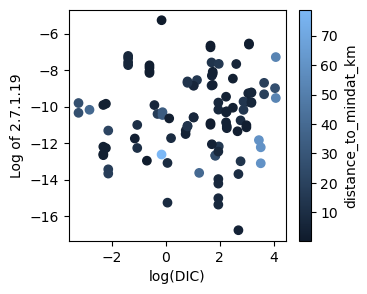

In [39]:
plt.figure(figsize=(3.5, 3))  

cmap = mcolors.LinearSegmentedColormap.from_list(
    'custom_blues',
    ['#0f1b2cff', '#7cb8f6ff']
)

# Scatter plot with color based on 'trench'
scatter = plt.scatter(np.log(merged_df['dic']), np.log(merged_df['2.3.3.8']), c=merged_df['distance_to_mindat_km'], cmap=cmap)


# Add colorbar
plt.colorbar(scatter, label='distance_to_mindat_km')

#plt.xscale('log')
plt.xlabel('log(DIC)')
plt.ylabel('Log of 2.7.1.19')
plt.show()

# Calculate Spearman correlation
#rho, p_value = spearmanr(np.log(clean_data['dic']), np.log(clean_data['sums_clique2']))

#print(f"Spearman correlation coefficient (rho): {rho}")
#print(f"P-value: {p_value}")

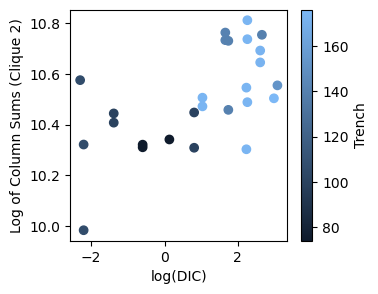

Spearman correlation coefficient (rho): 0.5845483060289691
P-value: 0.0017126087498798804


In [190]:
plt.figure(figsize=(3.5, 3))  

cmap = mcolors.LinearSegmentedColormap.from_list(
    'custom_blues',
    ['#0f1b2cff', '#7cb8f6ff']
)

# Scatter plot with color based on 'trench'
scatter = plt.scatter(np.log(envdata['dic']), np.log(envdata['sums_clique2']), c=envdata['trench'], cmap=cmap)


# Add colorbar
plt.colorbar(scatter, label='Trench')

#plt.xscale('log')
plt.xlabel('log(DIC)')
plt.ylabel('Log of Column Sums (Clique 2)')
plt.show()

# Calculate Spearman correlation
rho, p_value = spearmanr(np.log(clean_data['dic']), np.log(clean_data['sums_clique2']))

print(f"Spearman correlation coefficient (rho): {rho}")
print(f"P-value: {p_value}")

In [97]:


# Columns with all NaN or only one unique value
columns_to_remove = envdata.columns[envdata.isna().all() | (envdata.nunique() <= 1)]

# Print the column names that will be removed
print("Removed columns:", columns_to_remove.tolist())

# Now remove the columns
envdata = envdata.drop(columns=columns_to_remove)


Removed columns: ['Ti_aq', 'Pd_aq', 'Sn_aq', 'Sb_aq', 'Yh_aq', 'gd', 'sc', 'ConShelf', 'Time_rift', 'Water_type', 'iron_proteins']


/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufun

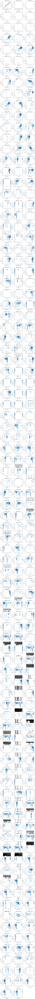

In [105]:
#### THIS ONE IS EVEN IOMPROVED COMPARED TO THE ONE BELOW BECAUSE IT IS RANKING APPARTION ORDER BY CORRELATION VALUE

# Store the correlation values and column names
correlations = []

# Calculate correlations for each column
for column in envdata.columns:
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values and filter for positive values to apply log
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{gene}'] > 0)]
        
        if not valid_data.empty:
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{gene}'])
            
            # Check if x or y are constant
            if x.std() != 0 and y.std() != 0:
                corr, _ = pearsonr(x, y)
            else:
                corr = float('nan')
        else:
            corr = float('nan')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = np.log(valid_data[f'{gene}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            # Calculate Spearman correlation
            corr, _ = spearmanr(numeric_categories, y)
        else:
            corr = float('nan')
    
    # Append only non-NaN correlations
    if not np.isnan(corr):
        correlations.append((column, corr))

# Sort columns by the absolute value of correlations
sorted_columns = sorted(correlations, key=lambda x: abs(x[1]), reverse=True)

# Now create the plots based on the sorted columns
n_rows = int(np.ceil(len(sorted_columns) / 3))
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))
plt.subplots_adjust(left=0.1,  right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)

axes = axes.flatten()

# Plot each column based on the sorted order
for i, (column, corr) in enumerate(sorted_columns):
    ax = axes[i]
    
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{gene}'] > 0)]
        
        if not valid_data.empty:
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{gene}'])
            
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(f'log({column})')
            ax.set_ylabel(f'log({gene})')
            ax.set_title(f'Pearson: {corr:.2f}')
        else:
            ax.set_title('No valid data')
    else:
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = np.log(valid_data[f'{gene}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(f'log({gene})')
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            ax.set_title(f'Spearman: {corr:.2f}')
        else:
            ax.set_title('No valid data')

# Turn off unused subplots
for j in range(len(sorted_columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufun

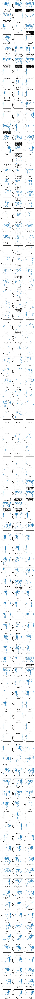

In [103]:
#### THIS ONE IS DONE BY CHATGPT TO SOLVE PROBLEM WWITH  PEARSON (but small risk it deleted some values im not sure)

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

plt.subplots_adjust(left=0.1,  right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values and filter for positive values to apply log
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{gene}'] > 0)]
        
        if not valid_data.empty:
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{gene}'])
            
            # Plot numeric columns
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(f'log({column})')
            ax.set_ylabel(f'log({gene})')
            
            # Check if x or y are constant (standard deviation == 0)
            if x.std() == 0 or y.std() == 0:
                corr = float('nan')  # Pearson is not defined for constant values
            else:
                # Calculate Pearson correlation coefficient
                corr, _ = pearsonr(x, y)
            
            ax.set_title(f'Pearson: {corr:.2f}')
        else:
            ax.set_title('No valid data')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = np.log(valid_data[f'{gene}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            # Plot categorical columns
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(f'log({gene})')
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            
            # Calculate and display Spearman correlation coefficient
            corr, _ = spearmanr(numeric_categories, y)
            ax.set_title(f'Spearman: {corr:.2f}')
        else:
            ax.set_title('No valid data')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    if j >= len(envdata.columns):
        axes[j].axis('off')

plt.tight_layout()
plt.show()


/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufun

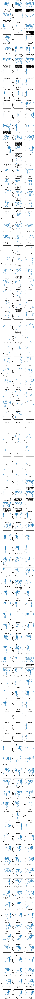

In [100]:
prk = "2.7.1.19"
rbc = "4.1.1.39"
acly = "2.3.3.8"
codh = "1.2.7.4"
fdh = "1.17.1.10"
mcr = "2.8.4.1"

gene = prk

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

plt.subplots_adjust(left=0.1,  right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        x = np.log(valid_data[column])
        y = np.log(valid_data[f'{gene}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(f'log({column})')
        ax.set_ylabel(f'log({gene})')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        x = valid_data[column]
        y = np.log(valid_data[f'{gene}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log({gene})')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


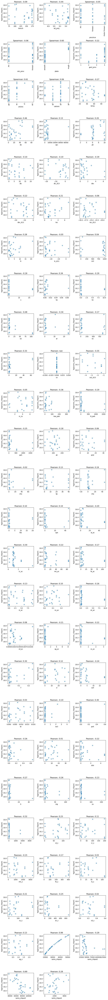

In [135]:
clique = 'clique1'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


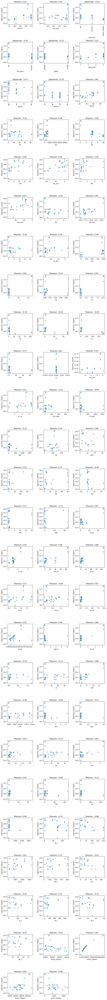

In [136]:
clique = 'clique2'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


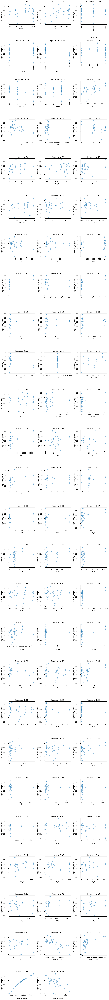

In [137]:
clique = 'clique3'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


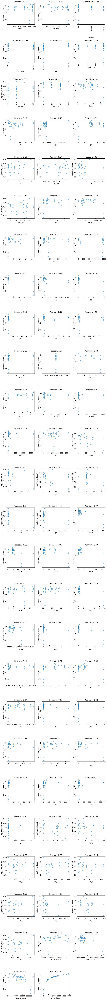

In [138]:
clique = 'clique4'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()
